# GRad cam and Gradient SHAP

In [ ]:
!pip install captum


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 65.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 70.0 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
opencv-contrib-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
opencv-python 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you ha

In [ ]:
import os

def get_file_paths_and_labels(root_dir, class_names):
    image_paths = []
    labels = []
    for idx, class_name in enumerate(class_names):
        class_dir = os.path.join(root_dir, class_name)
        if not os.path.exists(class_dir):
            continue
        for filename in os.listdir(class_dir):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_paths.append(os.path.join(class_dir, filename))
                labels.append(idx)
    return image_paths, labels


In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

def create_test_loader(test_dir, batch_size=32, num_workers=4):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    dataset = datasets.ImageFolder(test_dir, transform=transform)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
    return loader


In [ ]:
import torch
from torch.utils.data import Dataset
from PIL import Image

class BrainTumorDataset(Dataset):
    def __init__(self, image_paths, labels, seg_mask_paths=None, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.seg_mask_paths = seg_mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img = Image.open(self.image_paths[idx]).convert('RGB')
        label = self.labels[idx]

        if self.transform:
            img = self.transform(img)


        if self.seg_mask_paths:
            seg_mask = Image.open(self.seg_mask_paths[idx])

            return img, seg_mask, label
        else:
            return img, label


In [ ]:
def get_val_transforms():
    from torchvision import transforms
    return transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])


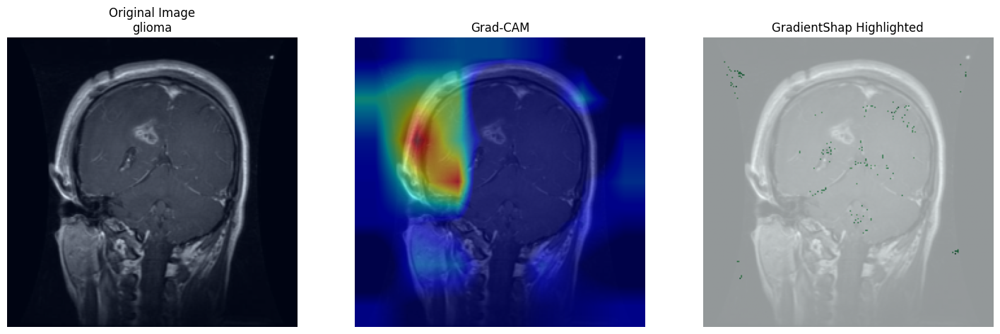

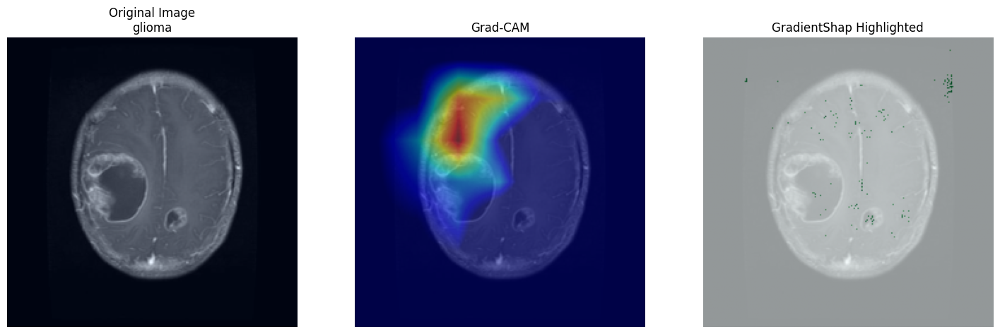

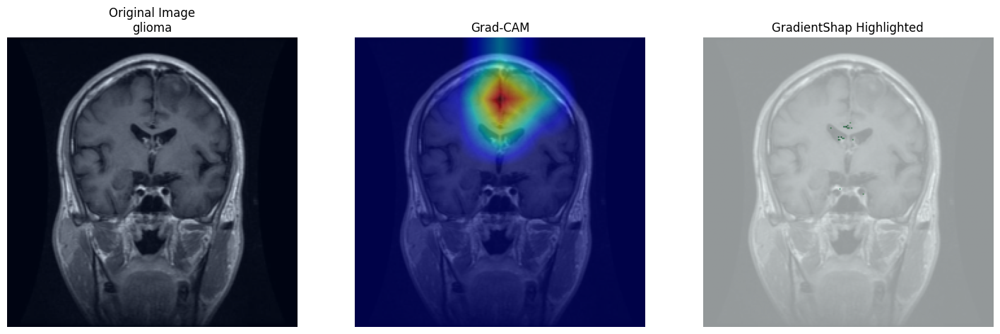

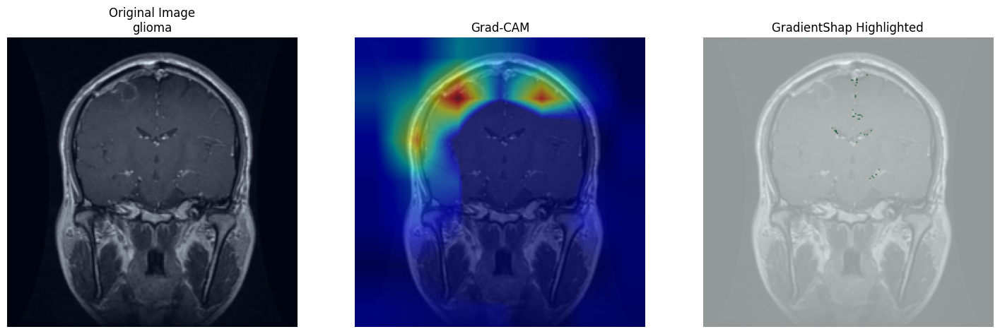

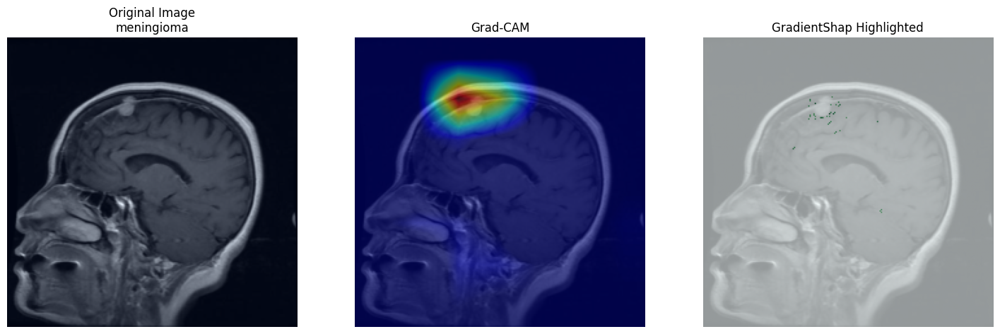

...

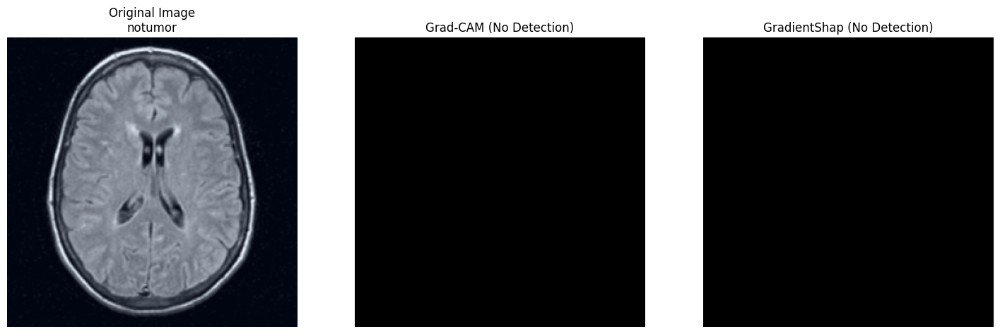

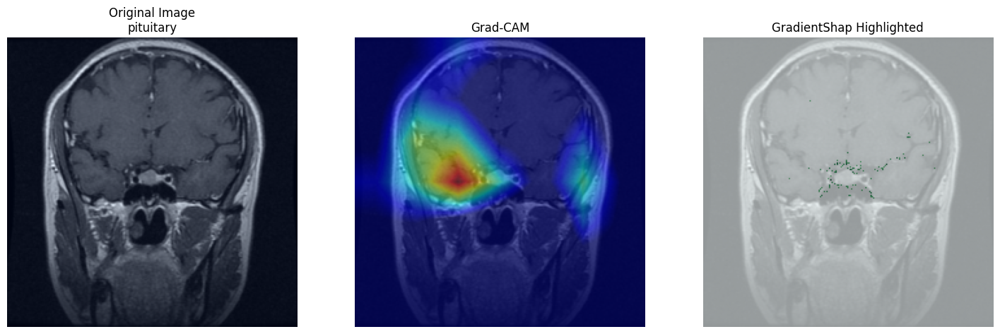

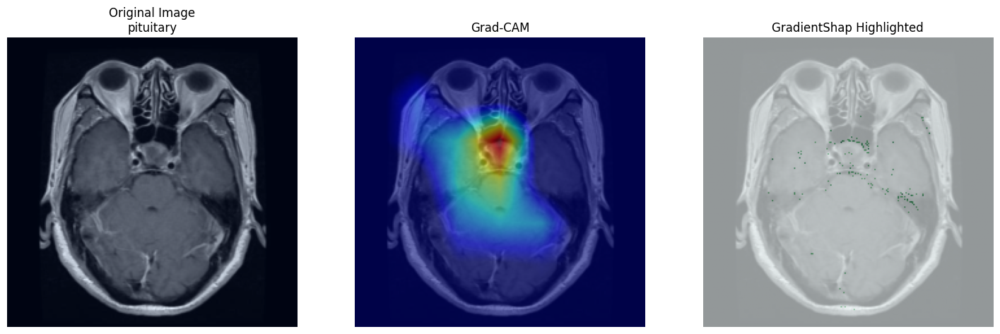

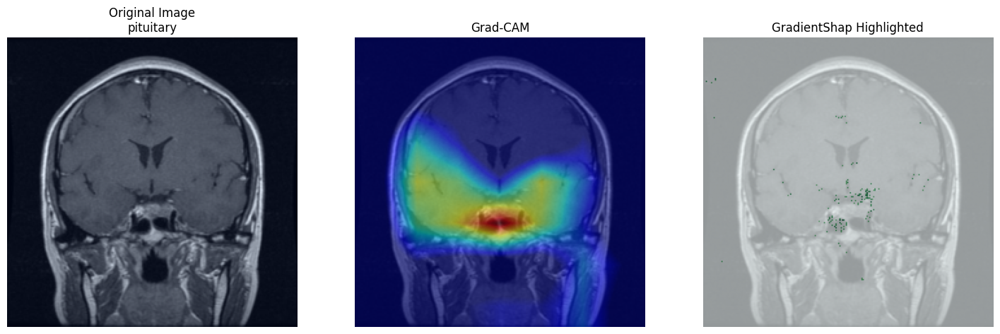

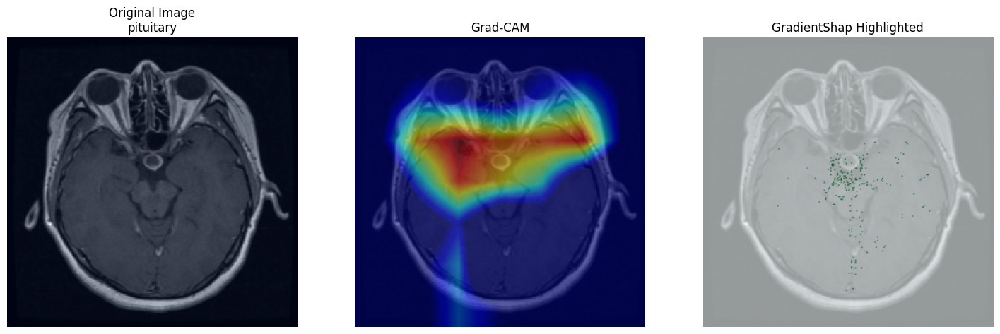

In [ ]:
import os
import random
import torch
from torchvision.models import convnext_base
from torchvision import transforms
from PIL import Image
from captum.attr import GradientShap, LayerGradCam
import numpy as np
import matplotlib.pyplot as plt


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
class_names = ['glioma', 'meningioma', 'notumor', 'pituitary']
test_dir = '/content/drive/MyDrive/ntest'


preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])


num_classes = len(class_names)
model = convnext_base(pretrained=False)
model.classifier[2] = torch.nn.Linear(model.classifier[2].in_features, num_classes)
model.load_state_dict(torch.load('convnext_base_trained.pth', map_location=device))
model.eval()
model.to(device)


def select_random_images(test_dir, class_names, num_images=4):
    image_paths = []
    labels = []
    for idx, cls in enumerate(class_names):
        cls_folder = os.path.join(test_dir, cls)
        images = [f for f in os.listdir(cls_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        selected = random.sample(images, min(num_images, len(images)))
        for img in selected:
            image_paths.append(os.path.join(cls_folder, img))
            labels.append(idx)
    return image_paths, labels


image_paths, labels = select_random_images(test_dir, class_names, num_images=4)

input_tensors = []
for path in image_paths:
    img = Image.open(path).convert('RGB')
    input_tensors.append(preprocess(img).unsqueeze(0))

input_batch = torch.cat(input_tensors).to(device)
labels_tensor = torch.tensor(labels, dtype=torch.long).to(device)


background = torch.zeros_like(input_batch).to(device)

gradient_shap = GradientShap(model)
layer_gradcam = LayerGradCam(model, model.features[-1])

shap_attributions = gradient_shap.attribute(input_batch, baselines=background, target=labels_tensor)

for i in range(len(input_batch)):
    img_np = input_batch[i].cpu().numpy().transpose(1, 2, 0)
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-8)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    axs[0].imshow(img_np)
    axs[0].set_title(f"Original Image\n{class_names[labels[i]]}")
    axs[0].axis('off')

    if class_names[labels[i]] == 'notumor':
        blank_heatmap = np.zeros(img_np.shape[:2])
        axs[1].imshow(blank_heatmap, cmap='gray')
        axs[1].set_title('Grad-CAM (No Detection)')
        axs[1].axis('off')

        axs[2].imshow(blank_heatmap, cmap='gray')
        axs[2].set_title('GradientShap (No Detection)')
        axs[2].axis('off')
    else:

        gradcam_attr = layer_gradcam.attribute(input_batch[i].unsqueeze(0), target=labels_tensor[i].item())
        gradcam_attr = torch.nn.functional.interpolate(gradcam_attr, size=img_np.shape[:2], mode='bilinear', align_corners=False)
        gradcam_map = gradcam_attr.squeeze().cpu().detach().numpy()
        gradcam_map = np.clip(gradcam_map, 0, None)
        if gradcam_map.max() != 0:
            gradcam_map /= gradcam_map.max()
        axs[1].imshow(img_np)
        axs[1].imshow(gradcam_map, cmap='jet', alpha=0.5)
        axs[1].set_title('Grad-CAM')
        axs[1].axis('off')

        shap_attr = shap_attributions[i].cpu().detach().numpy().transpose(1, 2, 0)
        shap_attr = np.clip(shap_attr, 0, None)
        if shap_attr.max() != 0:
            shap_attr /= shap_attr.max()
        shap_gray = np.mean(shap_attr, axis=2)


        thresh = 0.2
        shap_gray[shap_gray < thresh] = 0


        gamma = 0.5
        shap_gray = np.power(shap_gray, gamma)


        shap_gray /= shap_gray.max()

        axs[2].imshow(img_np)
        axs[2].imshow(shap_gray, cmap='Greens', alpha=0.6)
        axs[2].set_title('GradientShap Highlighted')
        axs[2].axis('off')

    plt.show()



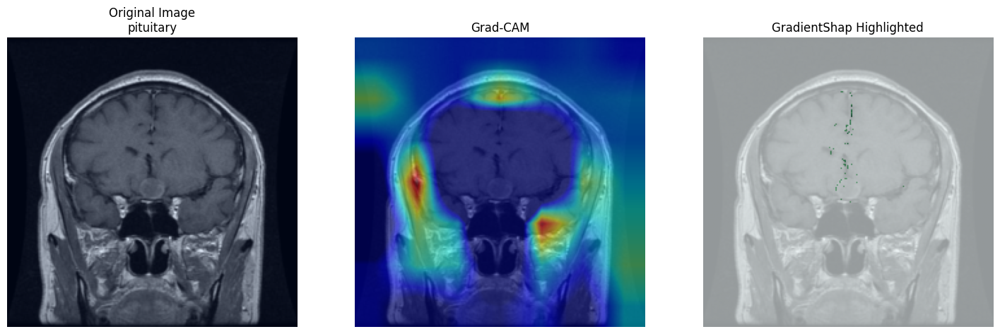

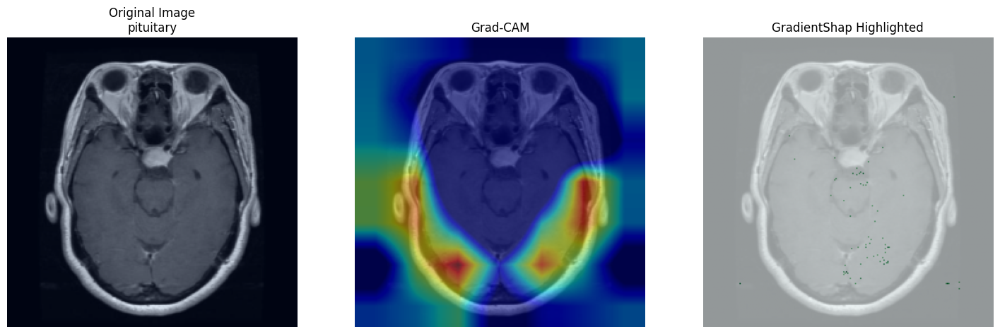

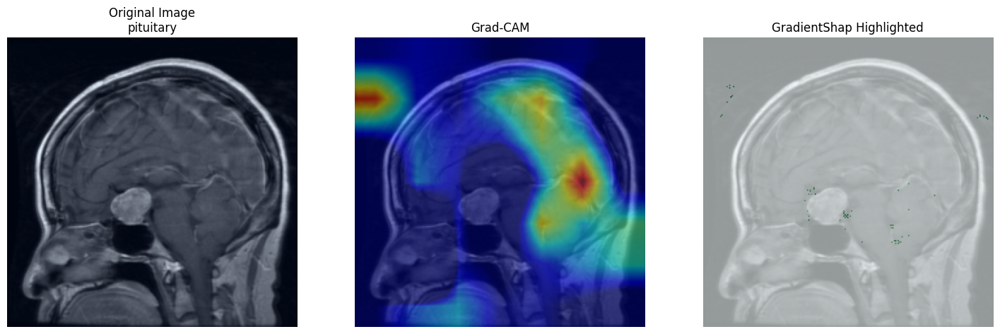

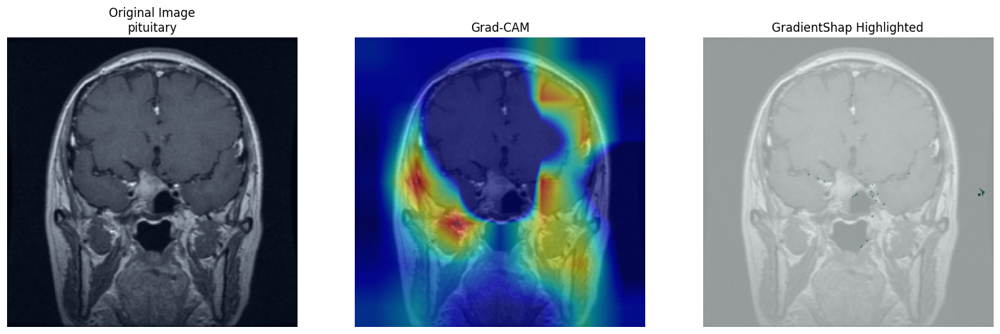

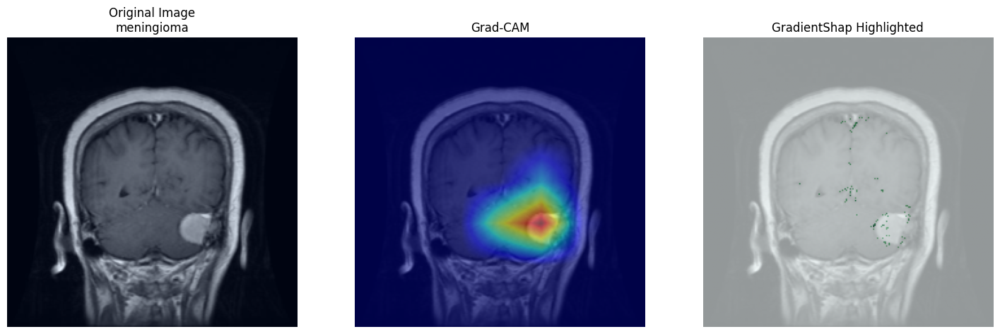

...

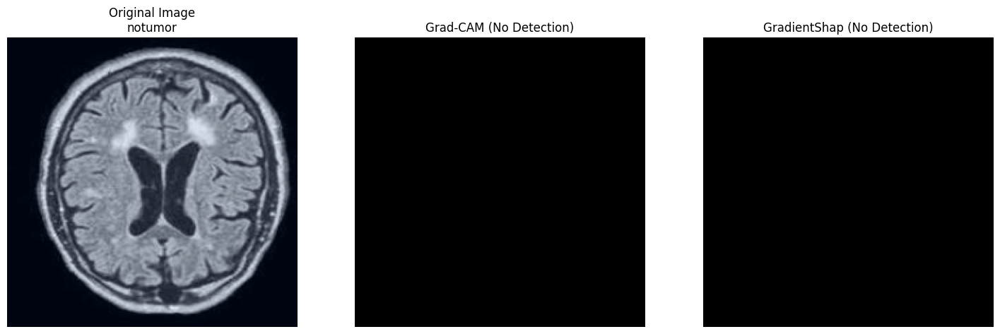

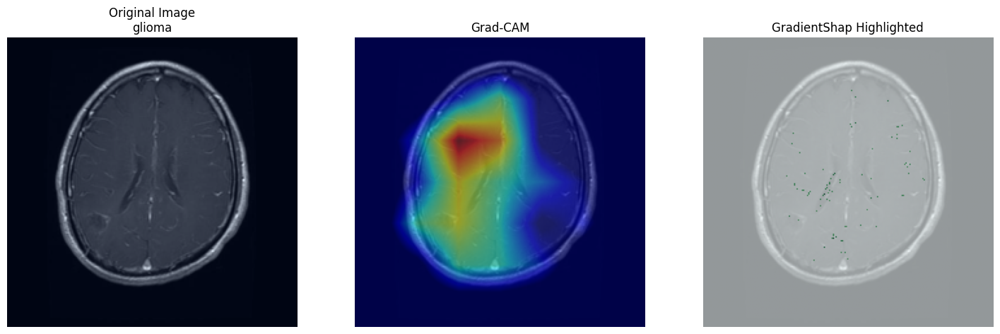

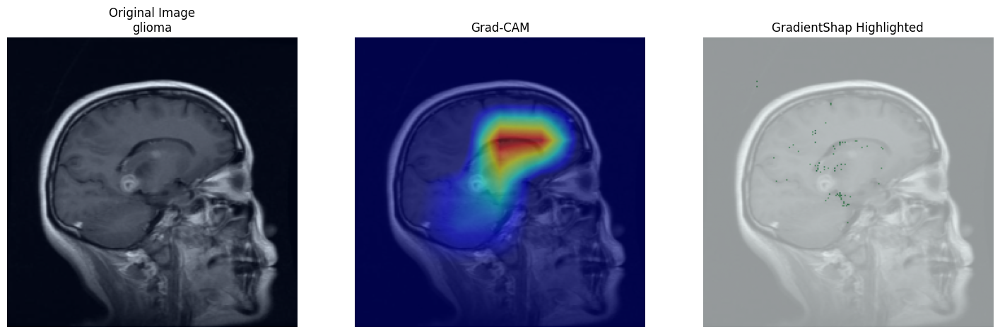

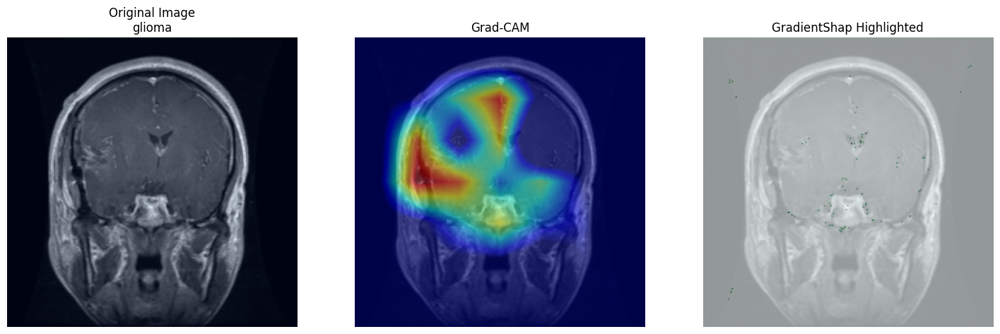

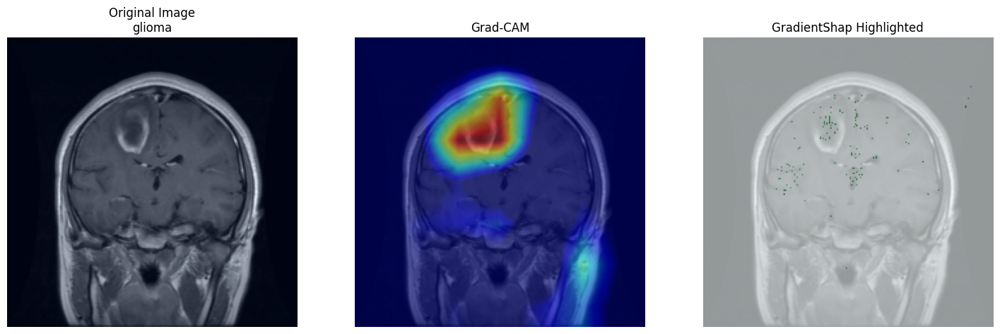

In [ ]:
import os
import random
import torch
from torchvision.models import convnext_base
from torchvision import transforms
from PIL import Image
from captum.attr import GradientShap, LayerGradCam
import numpy as np
import matplotlib.pyplot as plt


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
class_names = ['pituitary','meningioma', 'notumor',  'glioma']
test_dir = '/content/drive/MyDrive/newtest/Testing'


preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])


num_classes = len(class_names)
model = convnext_base(pretrained=False)
model.classifier[2] = torch.nn.Linear(model.classifier[2].in_features, num_classes)
model.load_state_dict(torch.load('convnext_base_trained.pth', map_location=device))
model.eval()
model.to(device)


def select_random_images(test_dir, class_names, num_images=4):
    image_paths = []
    labels = []
    for idx, cls in enumerate(class_names):
        cls_folder = os.path.join(test_dir, cls)
        images = [f for f in os.listdir(cls_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        selected = random.sample(images, min(num_images, len(images)))
        for img in selected:
            image_paths.append(os.path.join(cls_folder, img))
            labels.append(idx)
    return image_paths, labels


image_paths, labels = select_random_images(test_dir, class_names, num_images=4)

input_tensors = []
for path in image_paths:
    img = Image.open(path).convert('RGB')
    input_tensors.append(preprocess(img).unsqueeze(0))

input_batch = torch.cat(input_tensors).to(device)
labels_tensor = torch.tensor(labels, dtype=torch.long).to(device)


background = torch.zeros_like(input_batch).to(device)

gradient_shap = GradientShap(model)
layer_gradcam = LayerGradCam(model, model.features[-1])

shap_attributions = gradient_shap.attribute(input_batch, baselines=background, target=labels_tensor)

for i in range(len(input_batch)):
    img_np = input_batch[i].cpu().numpy().transpose(1, 2, 0)
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-8)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    axs[0].imshow(img_np)
    axs[0].set_title(f"Original Image\n{class_names[labels[i]]}")
    axs[0].axis('off')

    if class_names[labels[i]] == 'notumor':
        blank_heatmap = np.zeros(img_np.shape[:2])
        axs[1].imshow(blank_heatmap, cmap='gray')
        axs[1].set_title('Grad-CAM (No Detection)')
        axs[1].axis('off')

        axs[2].imshow(blank_heatmap, cmap='gray')
        axs[2].set_title('GradientShap (No Detection)')
        axs[2].axis('off')
    else:

        gradcam_attr = layer_gradcam.attribute(input_batch[i].unsqueeze(0), target=labels_tensor[i].item())
        gradcam_attr = torch.nn.functional.interpolate(gradcam_attr, size=img_np.shape[:2], mode='bilinear', align_corners=False)
        gradcam_map = gradcam_attr.squeeze().cpu().detach().numpy()
        gradcam_map = np.clip(gradcam_map, 0, None)
        if gradcam_map.max() != 0:
            gradcam_map /= gradcam_map.max()
        axs[1].imshow(img_np)
        axs[1].imshow(gradcam_map, cmap='jet', alpha=0.5)
        axs[1].set_title('Grad-CAM')
        axs[1].axis('off')

        shap_attr = shap_attributions[i].cpu().detach().numpy().transpose(1, 2, 0)
        shap_attr = np.clip(shap_attr, 0, None)
        if shap_attr.max() != 0:
            shap_attr /= shap_attr.max()
        shap_gray = np.mean(shap_attr, axis=2)


        thresh = 0.2
        shap_gray[shap_gray < thresh] = 0


        gamma = 0.5
        shap_gray = np.power(shap_gray, gamma)


        shap_gray /= shap_gray.max()

        axs[2].imshow(img_np)
        axs[2].imshow(shap_gray, cmap='Greens', alpha=0.6)
        axs[2].set_title('GradientShap Highlighted')
        axs[2].axis('off')

    plt.show()

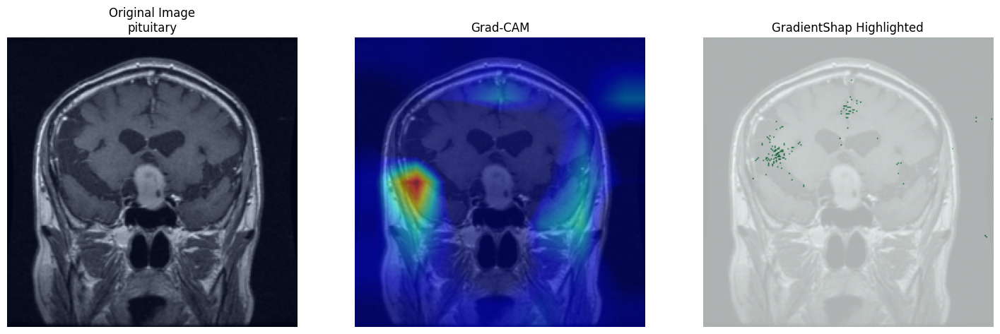

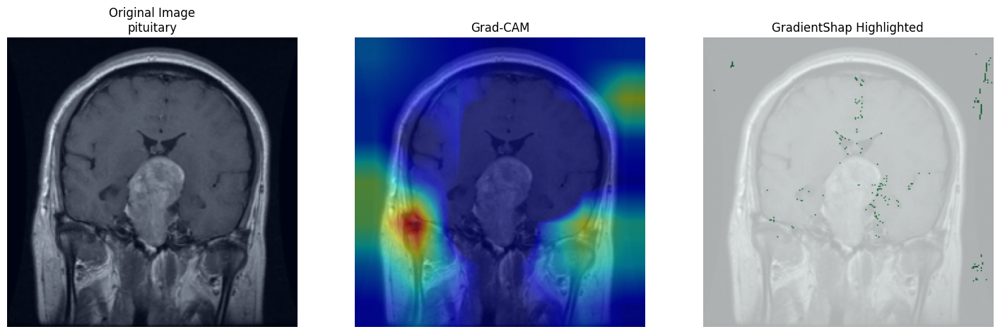

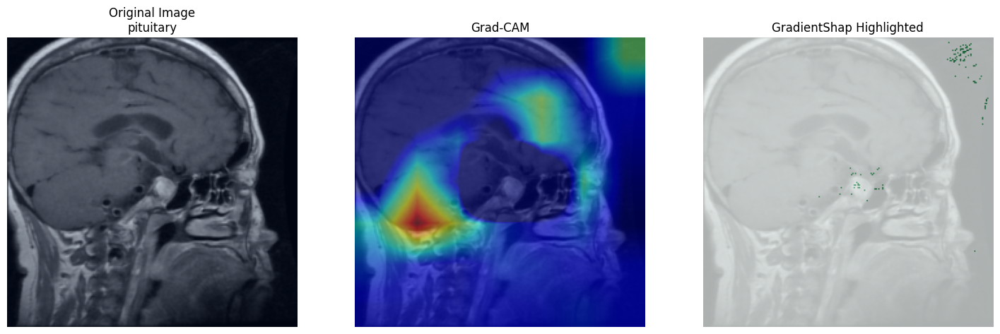

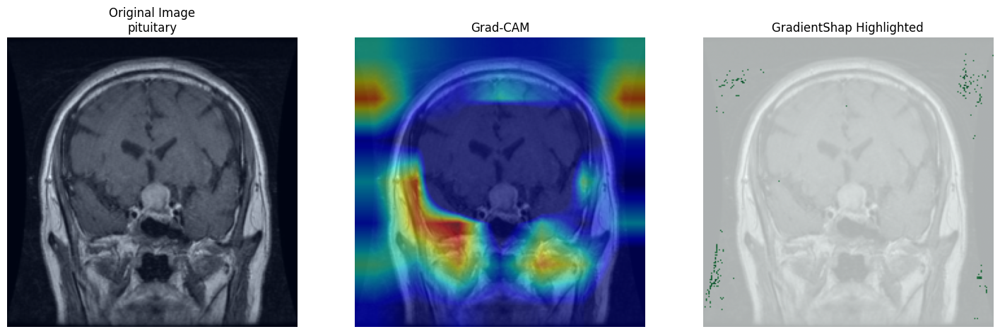

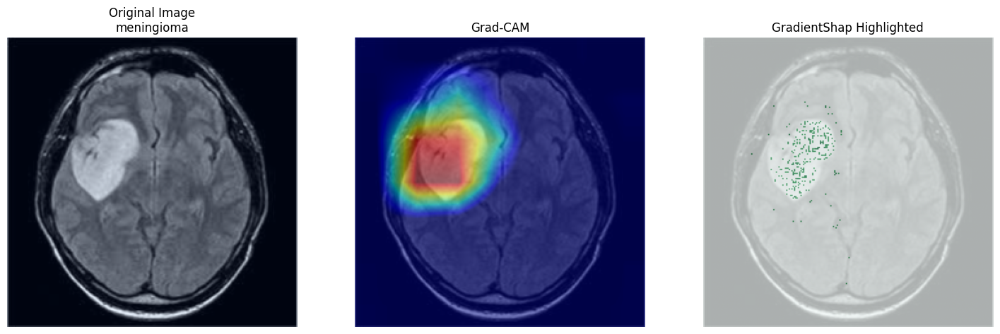

...

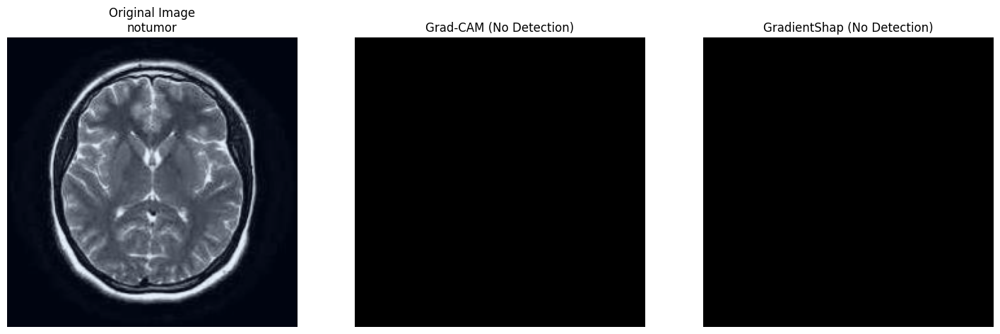

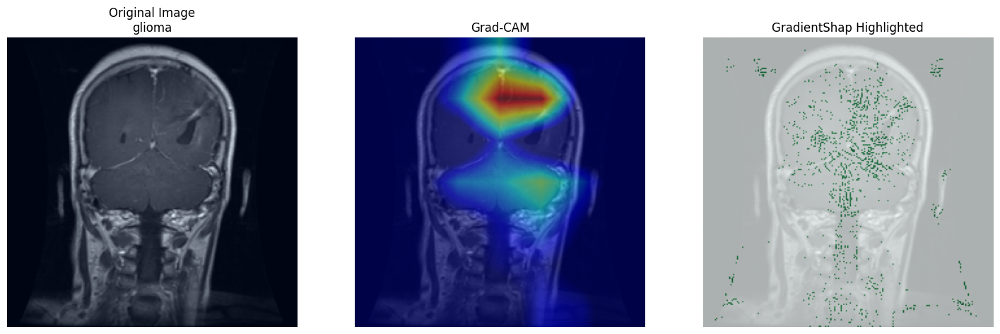

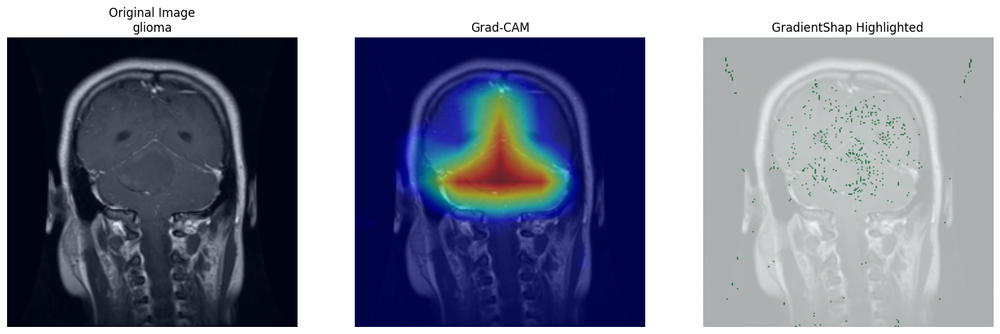

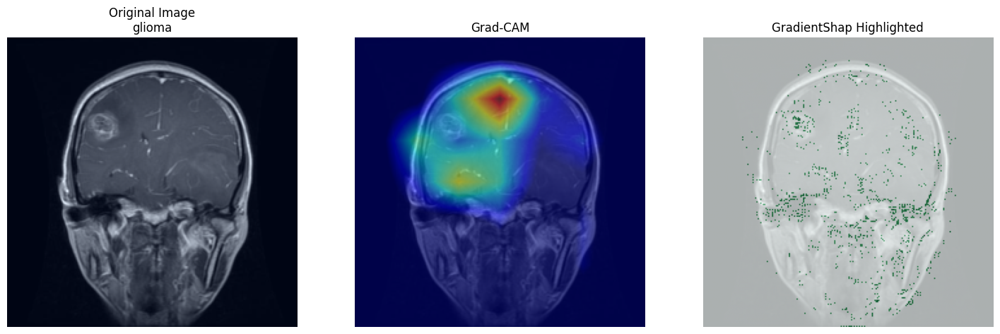

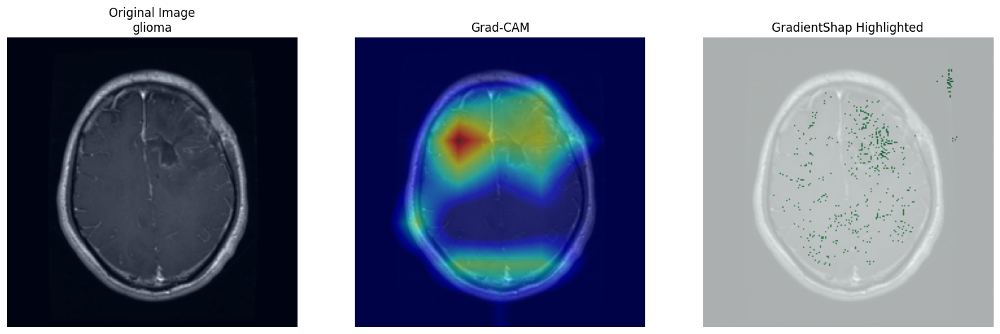

In [ ]:
import os
import random
import torch
from torchvision.models import convnext_base
from torchvision import transforms
from PIL import Image
from captum.attr import GradientShap, LayerGradCam
import numpy as np
import matplotlib.pyplot as plt


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
class_names = ['pituitary','meningioma', 'notumor',  'glioma']
test_dir = '/content/drive/MyDrive/testcase/test'


preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225]),
])


num_classes = len(class_names)
model = convnext_base(pretrained=False)
model.classifier[2] = torch.nn.Linear(model.classifier[2].in_features, num_classes)
model.load_state_dict(torch.load('convnext_base_trained.pth', map_location=device))
model.eval()
model.to(device)


def select_random_images(test_dir, class_names, num_images=4):
    image_paths = []
    labels = []
    for idx, cls in enumerate(class_names):
        cls_folder = os.path.join(test_dir, cls)
        images = [f for f in os.listdir(cls_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        selected = random.sample(images, min(num_images, len(images)))
        for img in selected:
            image_paths.append(os.path.join(cls_folder, img))
            labels.append(idx)
    return image_paths, labels


image_paths, labels = select_random_images(test_dir, class_names, num_images=4)

input_tensors = []
for path in image_paths:
    img = Image.open(path).convert('RGB')
    input_tensors.append(preprocess(img).unsqueeze(0))

input_batch = torch.cat(input_tensors).to(device)
labels_tensor = torch.tensor(labels, dtype=torch.long).to(device)


background = torch.zeros_like(input_batch).to(device)

gradient_shap = GradientShap(model)
layer_gradcam = LayerGradCam(model, model.features[-1])

shap_attributions = gradient_shap.attribute(input_batch, baselines=background, target=labels_tensor)

for i in range(len(input_batch)):
    img_np = input_batch[i].cpu().numpy().transpose(1, 2, 0)
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-8)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    axs[0].imshow(img_np)
    axs[0].set_title(f"Original Image\n{class_names[labels[i]]}")
    axs[0].axis('off')

    if class_names[labels[i]] == 'notumor':
        blank_heatmap = np.zeros(img_np.shape[:2])
        axs[1].imshow(blank_heatmap, cmap='gray')
        axs[1].set_title('Grad-CAM (No Detection)')
        axs[1].axis('off')

        axs[2].imshow(blank_heatmap, cmap='gray')
        axs[2].set_title('GradientShap (No Detection)')
        axs[2].axis('off')
    else:

        gradcam_attr = layer_gradcam.attribute(input_batch[i].unsqueeze(0), target=labels_tensor[i].item())
        gradcam_attr = torch.nn.functional.interpolate(gradcam_attr, size=img_np.shape[:2], mode='bilinear', align_corners=False)
        gradcam_map = gradcam_attr.squeeze().cpu().detach().numpy()
        gradcam_map = np.clip(gradcam_map, 0, None)
        if gradcam_map.max() != 0:
            gradcam_map /= gradcam_map.max()
        axs[1].imshow(img_np)
        axs[1].imshow(gradcam_map, cmap='jet', alpha=0.5)
        axs[1].set_title('Grad-CAM')
        axs[1].axis('off')

        shap_attr = shap_attributions[i].cpu().detach().numpy().transpose(1, 2, 0)
        shap_attr = np.clip(shap_attr, 0, None)
        if shap_attr.max() != 0:
            shap_attr /= shap_attr.max()
        shap_gray = np.mean(shap_attr, axis=2)


        thresh = 0.1
        shap_gray[shap_gray < thresh] = 0


        gamma = 0.2
        shap_gray = np.power(shap_gray, gamma)


        shap_gray /= shap_gray.max()

        axs[2].imshow(img_np)
        axs[2].imshow(shap_gray, cmap='Greens', alpha=0.7)
        axs[2].set_title('GradientShap Highlighted')
        axs[2].axis('off')

    plt.show()